In [65]:
from pathlib import Path
from PIL import Image
import cv2
from torchvision import transforms
import numpy as np
import torchs
from matplotlib import pyplot as plt
import random
import jpeg4py as jpeg
import tqdm

In [3]:
def pathlib_to_list(paths):
    return list(map(str, paths))

In [11]:
data_dir = Path("../data/dataset_new/train")

In [16]:
img_list = pathlib_to_list(data_dir.rglob("*.jpg"))
matte_list = pathlib_to_list(data_dir.rglob("*.png"))
matte_list = [x for x in matte_list if "trimap" not in x]

In [17]:
len(img_list), len(matte_list)

(19138, 19138)

In [35]:
image_path = random.choice(img_list)
matte_path = image_path[:-3]+'png'

### Reading .jpg files

In [66]:
%%time
for image_path in tqdm.tqdm(img_list):
    pil_image = Image.open(image_path)

100%|██████████| 19138/19138 [02:37<00:00, 121.76it/s]

CPU times: user 7.22 s, sys: 3.34 s, total: 10.6 s
Wall time: 2min 37s


In [67]:
%%time
for image_path in tqdm.tqdm(img_list):
    cv2_image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)

100%|██████████| 19138/19138 [06:32<00:00, 48.76it/s]

CPU times: user 6min 17s, sys: 1min 27s, total: 7min 45s
Wall time: 6min 32s


In [68]:
%%time
for image_path in tqdm.tqdm(img_list):
    jpeg_image = jpeg.JPEG(image_path).decode()

100%|██████████| 19138/19138 [01:16<00:00, 251.10it/s]

CPU times: user 1min 10s, sys: 2.1 s, total: 1min 12s
Wall time: 1min 16s


In [70]:
len(img_list), jpeg_image.shape

(19138, (1080, 1920, 3))

### Reading .png files

In [71]:
%%time
for image_path in tqdm.tqdm(matte_list):
    pil_image = Image.open(image_path)

100%|██████████| 19138/19138 [02:42<00:00, 117.54it/s]

CPU times: user 6.63 s, sys: 2.94 s, total: 9.57 s
Wall time: 2min 42s


In [72]:
%%time
for image_path in tqdm.tqdm(matte_list):
    cv2_image = cv2.cvtColor(cv2.imread(image_path), cv2.COLOR_BGR2RGB)

100%|██████████| 19138/19138 [05:54<00:00, 54.02it/s]

CPU times: user 5min 49s, sys: 1min 28s, total: 7min 18s
Wall time: 5min 54s


In [73]:
len(matte_list), cv2_image.shape

(19138, (1080, 1920, 3))

### Resizing

In [74]:
import albumentations as A

In [80]:
random_image_path = random.choice(img_list)
random_matte_path = random_image_path[:-3]+'png'

In [106]:
image = jpeg.JPEG(random_image_path).decode()
matte = np.array(Image.open(random_matte_path))

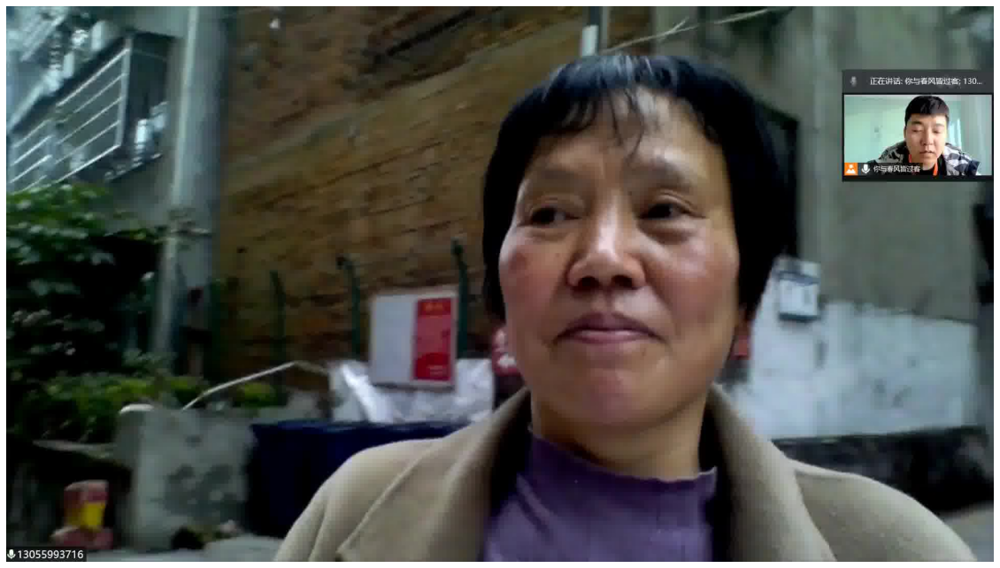

In [97]:
plt.figure(figsize=(20, 20))
plt.imshow(image)
plt.axis("Off")
plt.show()

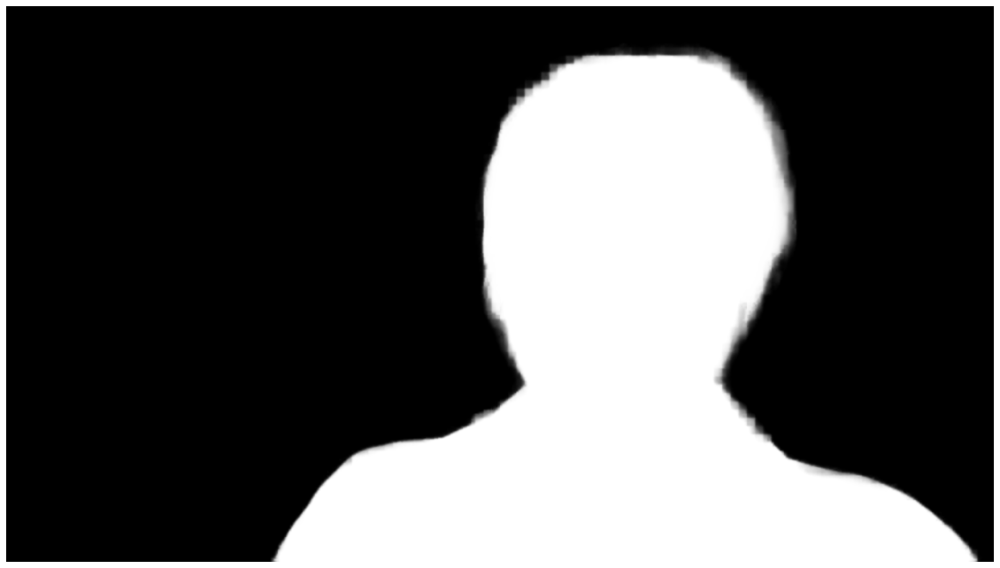

In [108]:
plt.figure(figsize=(20, 20))
plt.imshow(matte, cmap='gray')
plt.axis("Off")
plt.show()

In [98]:
image.shape

(1080, 1920, 3)

In [263]:
transforms = A.Compose([
    A.Resize(256, int(256 / ratio), interpolation=1),
    A.Resize(1080, int(1080 / ratio), interpolation=1)
])

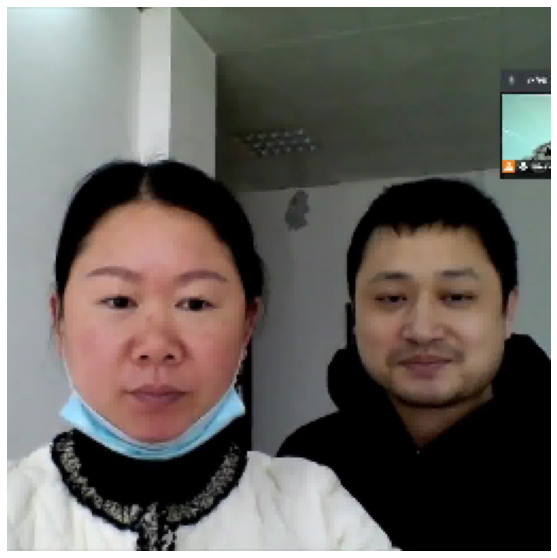

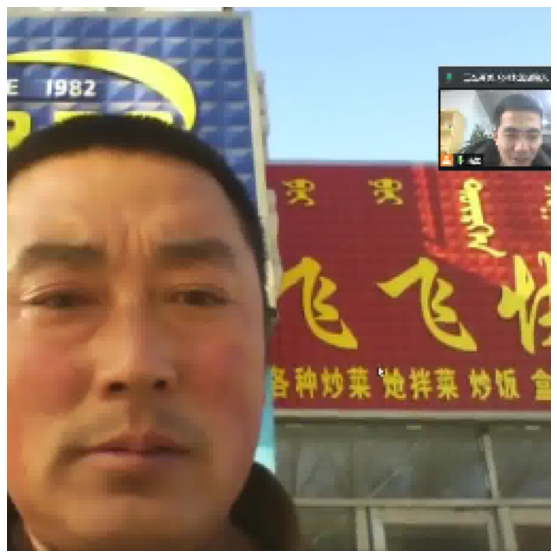

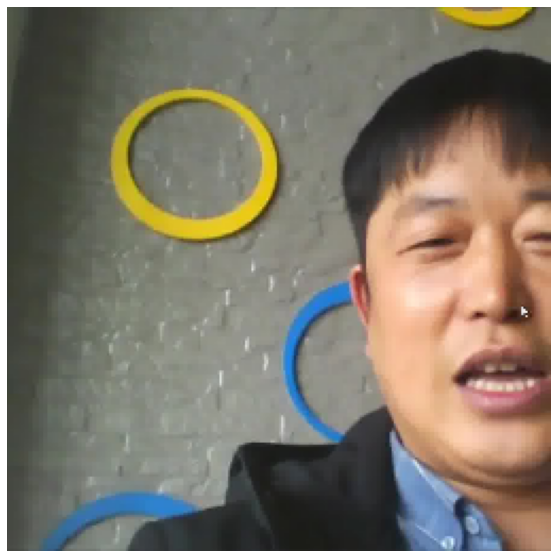

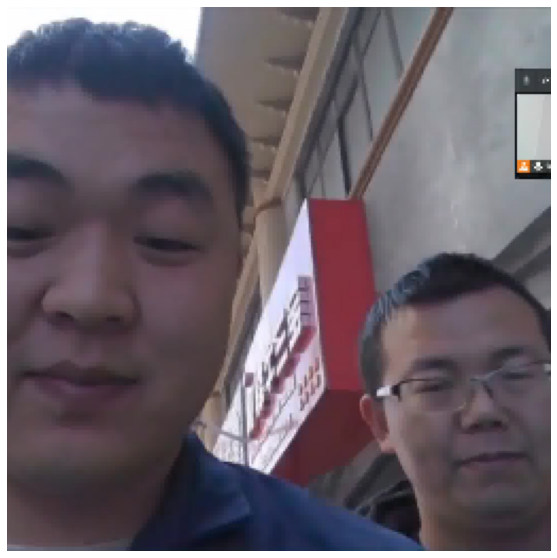

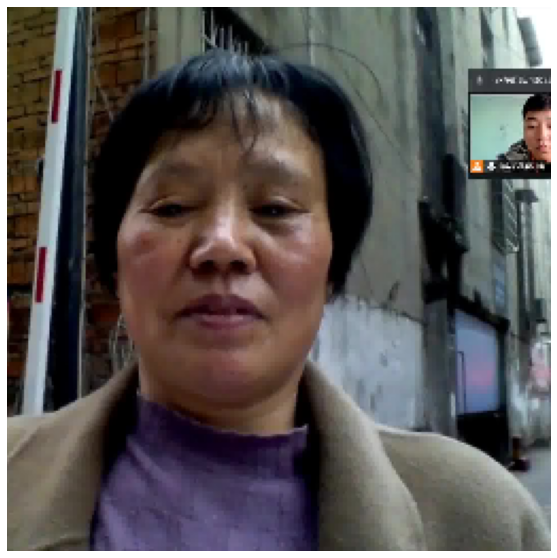

...

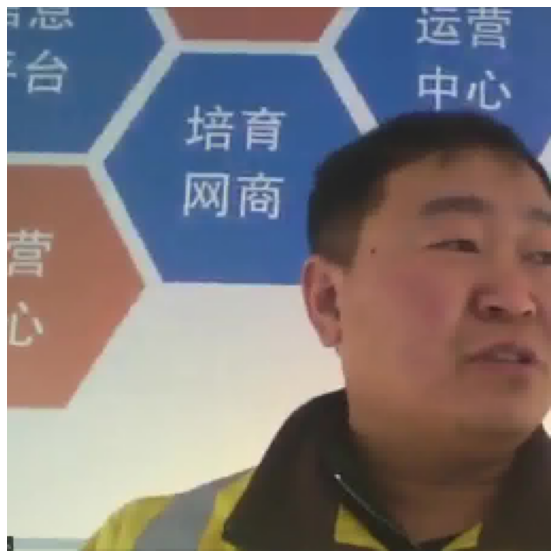

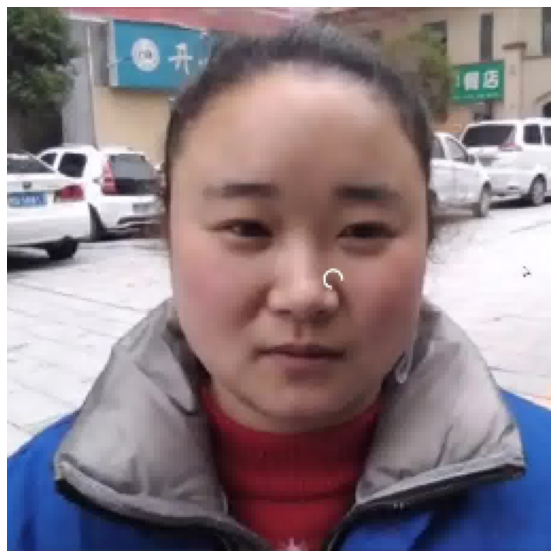

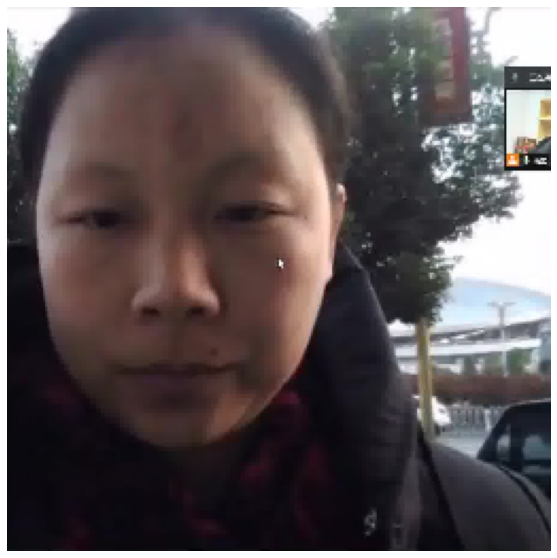

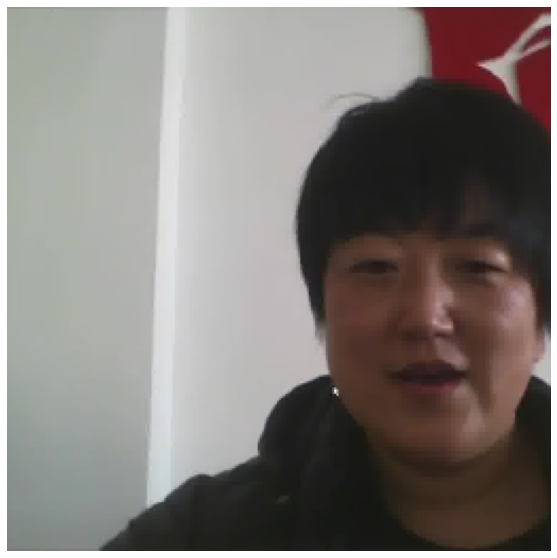

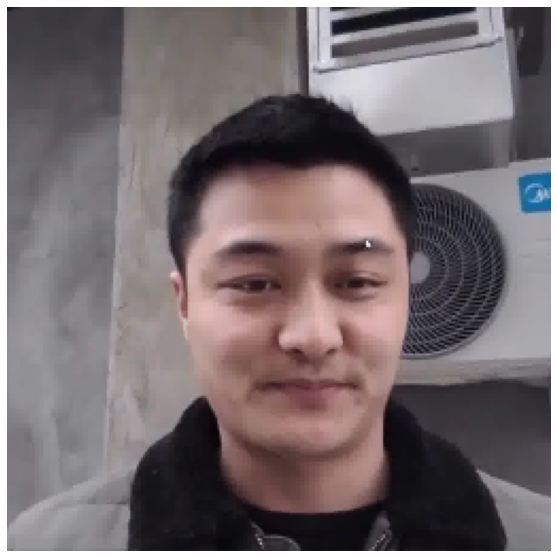

In [313]:
for image_path in random.sample(img_list, 100):
    image = jpeg.JPEG(image_path).decode()
    transforms = A.Compose([
        A.Resize(256, int(256 / ratio), interpolation=1),
        A.RandomCrop(256, 256),
    ])
    image_t, matte_t = transforms(image=image, mask=matte).values()
    plt.figure(figsize=(10, 10))
    plt.imshow(image_t)
    plt.axis("Off")
    plt.show()

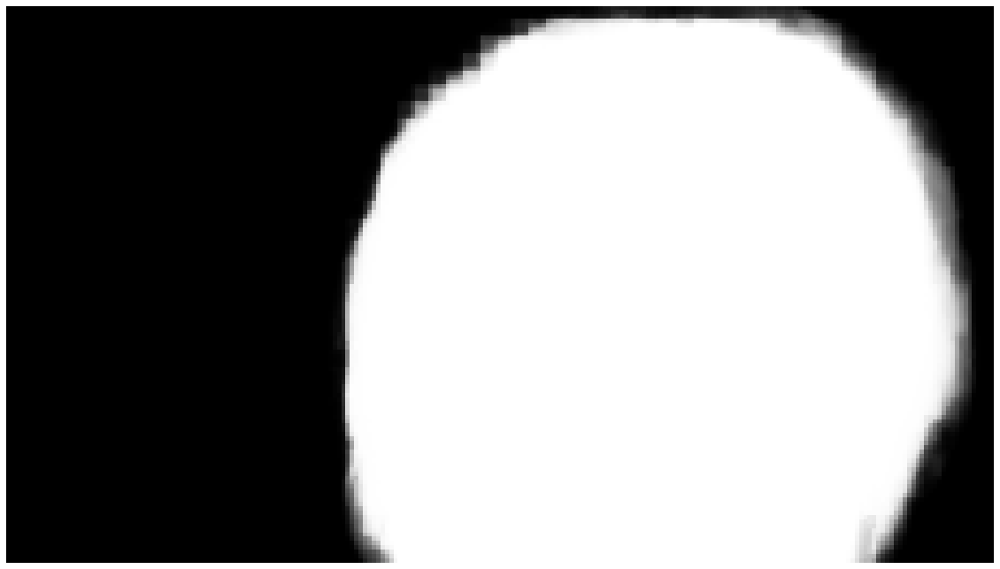

In [288]:
plt.figure(figsize=(20, 20))
plt.imshow(matte_t, cmap='gray')
plt.axis("Off")
plt.show()

In [267]:
np.mean(image - image_t), np.mean(matte - matte_t)

(69.83168997556584, 4.641006462191358)